# Stable Diffusion with 🤗 Diffusers

**Pedro Cuenca, Patrick von Platen, Suraj Patil, Jeremy Howard**

Chances are you'll have seen examples in Twitter (and elsewhere) of images generated by typing a short description of the scene you want to create. This is the culmination of years of work in generative models. This notebook introduces Stable Diffusion, the highest-quality open source text to image model as of now. It's also small enough to run in consumer GPUs rather than in a datacenter. We use the 🤗 Hugging Face [🧨 Diffusers library](https://github.com/huggingface/diffusers), which is currently our recommended library for using diffusion models.

As we'll see during the course, understanding state-of-the-art generative models requires a deep understanding of many of the fundamental blocks in modern machine learning models. This notebook shows what Stable Diffusion can do and a glimpse of its main components.

_If you open this notebook in Colab, or if you get type errors when generating your first image, please uncomment and run the following cell._

# Install, Imports, Setup

In [1]:
print('Setting up')
try:
    from diffusers import __version__ 
except ModuleNotFoundError:
    print('Installing required packages')
    !pip install -Uqq diffusers>0.4.1 transformers fastcore fastdownload
    from diffusers import __version__ 
assert __version__ > '0.4.1', f"version is {__version__} and should be > 0.4.1"

Installing required packages


In [8]:
from PIL import Image
from fastcore.all import concat
import torch, logging
from pathlib import Path
from huggingface_hub import notebook_login
from diffusers import StableDiffusionPipeline
from diffusers import StableDiffusionImg2ImgPipeline
from fastdownload import FastDownload
from PIL import Image
import matplotlib.pyplot as plt
logging.disable(logging.WARNING)

torch.manual_seed(1)
if not (Path.home()/'.huggingface'/'token').exists(): notebook_login()

Login successful
Your token has been saved to /root/.huggingface/token


# Using Stable Diffusion

To run Stable Diffusion on your computer you have to accept the model license. It's an open CreativeML OpenRail-M license that claims no rights on the outputs you generate and prohibits you from deliberately producing illegal or harmful content. The [model card](https://huggingface.co/CompVis/stable-diffusion-v1-4) provides more details. If you do accept the license, you need to be a registered user in 🤗 Hugging Face Hub and use an access token for the code to work. You have two options to provide your access token:

* Use the `huggingface-cli login` command-line tool in your terminal and paste your token when prompted. It will be saved in a file in your computer.
* Or use `notebook_login()` in a notebook, which does the same thing.

### Stable Diffusion Pipeline

In [ ]:
pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", revision="fp16", torch_dtype=torch.float16).to("cuda")

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

The weights are cached in your home directory by default.

In [ ]:
!ls -l ~/.cache/huggingface/diffusers/

total 8
drwxr-xr-x 5 ubuntu ubuntu 4096 Oct 23 04:34 models--CompVis--stable-diffusion-v1-4
drwxr-xr-x 5 ubuntu ubuntu 4096 Oct 23 04:38 models--pcuenq--jh_dreambooth_1000


We are now ready to use the pipeline to start creating images.

### What is Stable Diffusion

There are three main components in latent diffusion.

1. An autoencoder (VAE).
2. A [U-Net](https://colab.research.google.com/github/huggingface/notebooks/blob/main/diffusers/diffusers_intro.ipynb#scrollTo=wW8o1Wp0zRkq).
3. A text-encoder, *e.g.* [CLIP's Text Encoder](https://huggingface.co/docs/transformers/model_doc/clip#transformers.CLIPTextModel).

The output of the U-Net, being the noise residual, is used to compute a denoised latent image representation via a scheduler algorithm. Many different scheduler algorithms can be used for this computation, each having its pros and cons. For Stable Diffusion, we recommend using one of:

- [PNDM scheduler](https://github.com/huggingface/diffusers/blob/main/src/diffusers/schedulers/scheduling_pndm.py) (used by default)
- [DDIM scheduler](https://github.com/huggingface/diffusers/blob/main/src/diffusers/schedulers/scheduling_ddim.py)
- [K-LMS scheduler](https://github.com/huggingface/diffusers/blob/main/src/diffusers/schedulers/scheduling_lms_discrete.py)

### Latents and callbacks

Stable Diffusion is based on a particular type of diffusion model called **Latent Diffusion**, proposed in [High-Resolution Image Synthesis with Latent Diffusion Models](https://arxiv.org/abs/2112.10752).

General diffusion models are machine learning systems that are trained to *denoise* random gaussian noise step by step, to get to a sample of interest, such as an *image*. For a more detailed overview of how they work, check [this colab](https://colab.research.google.com/github/huggingface/notebooks/blob/main/diffusers/diffusers_intro.ipynb).

Diffusion models have shown to achieve state-of-the-art results for generating image data. But one downside of diffusion models is that the reverse denoising process is slow. In addition, these models consume a lot of memory because they operate in pixel space, which becomes unreasonably expensive when generating high-resolution images. Therefore, it is challenging to train these models and also use them for inference.

Latent diffusion can reduce the memory and compute complexity by applying the diffusion process over a lower dimensional _latent_ space, instead of using the actual pixel space. This is the key difference between standard diffusion and latent diffusion models: **in latent diffusion the model is trained to generate latent (compressed) representations of the images.** 

The Stable Diffusion pipeline can send intermediate latents to a callback function we provide. By running these latents through the image decoder (the `vae` component of the pipeline), we can see how the denoising process progresses and the image unfolds.

  0%|          | 0/51 [00:00<?, ?it/s]

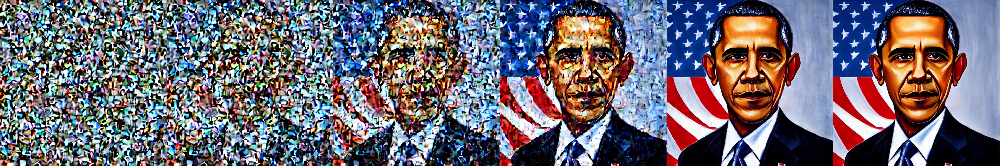

In [ ]:
vae = pipe.vae
images = []

person = 'Obama'
seed = 1988

def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

def latents_callback(i, t, latents):
    latents = 1 / 0.18215 * latents
    image = vae.decode(latents).sample[0]
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.cpu().permute(1, 2, 0).numpy()
    images.extend(pipe.numpy_to_pil(image))

prompt = f"Portrait painting of {person} looking serious."
torch.manual_seed(seed)
final_image = pipe(prompt, callback=latents_callback, callback_steps=12).images[0]
images.append(final_image)

image_grid(images, rows=1, cols=len(images))

  0%|          | 0/51 [00:00<?, ?it/s]

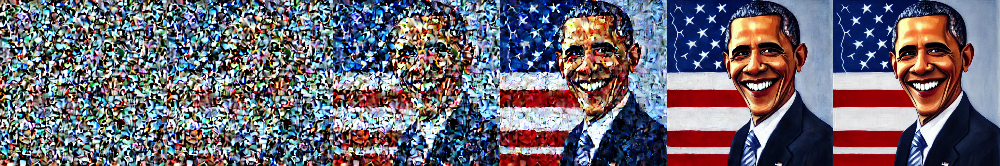

In [ ]:
images = []
prompt = f"Portrait painting of {person} looking happy."
torch.manual_seed(seed)
final_image = pipe(prompt, callback=latents_callback, callback_steps=12).images[0]
images.append(final_image)

image_grid(images, rows=1, cols=len(images))

  0%|          | 0/51 [00:00<?, ?it/s]

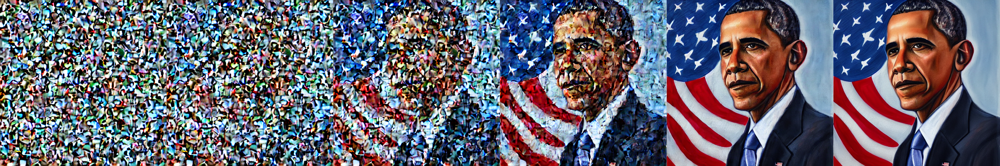

In [ ]:
images = []
prompt = f"Portrait painting of {person} looking pensive."
torch.manual_seed(seed)
final_image = pipe(prompt, callback=latents_callback, callback_steps=12).images[0]
images.append(final_image)

image_grid(images, rows=1, cols=len(images))

  0%|          | 0/51 [00:00<?, ?it/s]

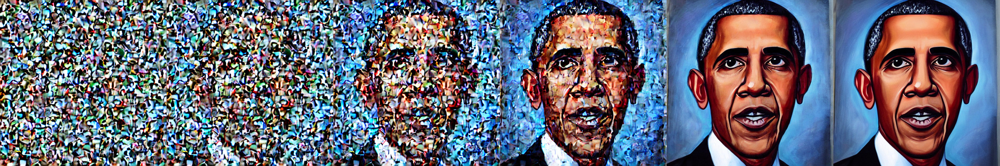

In [ ]:
images = []
prompt = f"Portrait painting of {person} looking scared."
torch.manual_seed(seed)
final_image = pipe(prompt, callback=latents_callback, callback_steps=12).images[0]
images.append(final_image)

image_grid(images, rows=1, cols=len(images))

  0%|          | 0/51 [00:00<?, ?it/s]

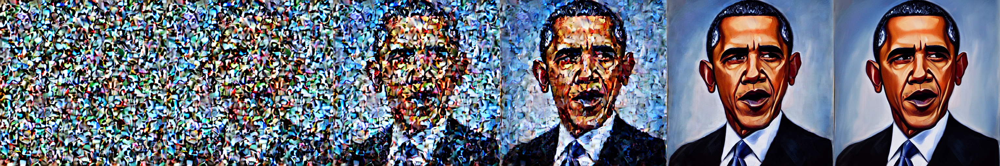

In [ ]:
images = []
prompt = f"Portrait painting of {person} looking furious."
torch.manual_seed(seed)
final_image = pipe(prompt, callback=latents_callback, callback_steps=12).images[0]
images.append(final_image)

image_grid(images, rows=1, cols=len(images))

**Why is latent diffusion fast and efficient?**

Since the U-Net of latent diffusion models operates on a low dimensional space, it greatly reduces the memory and compute requirements compared to pixel-space diffusion models. For example, the autoencoder used in Stable Diffusion has a reduction factor of 8 but uses 4 channels instead of 3. This means that an image of shape `(3, 512, 512)` becomes `(4, 64, 64)` in latent space, which requires `8 × 8 × 3/4 = 48` times less memory.

This is why it's possible to generate `512 × 512` images so quickly, even on 16GB Colab GPUs!

In [ ]:
del pipe

# Looking inside the pipeline

## Step by step

The inference pipeline is just a small piece of code that plugs the components together and performs the inference loop. [This is all there it to is](https://github.com/huggingface/diffusers/blob/main/src/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion.py#L204).

We'll go through the process of loading and plugging the pieces to see how we could have written it ourselves. We'll start by loading all the modules that we need from their pretrained weights.

First, we need the text encoder and the tokenizer. These come from the text portion of a standard CLIP model, so we'll use the weights released by Open AI.

In [ ]:
from transformers import CLIPTextModel, CLIPTokenizer

In [ ]:
tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-large-patch14", torch_dtype=torch.float16)
text_encoder = CLIPTextModel.from_pretrained("openai/clip-vit-large-patch14", torch_dtype=torch.float16).to("cuda")

Downloading:   0%|          | 0.00/961k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/525k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/389 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/905 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/4.52k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.71G [00:00<?, ?B/s]

Next we'll load the `vae` and the `unet`. These are distinct models whose weights are stored inside folders of the Stable Diffusion repository. We can use the `subfolder` argument to refer to [these locations](https://huggingface.co/CompVis/stable-diffusion-v1-4/tree/main).

In [ ]:
from diffusers import AutoencoderKL, UNet2DConditionModel

In [ ]:
# Here we use a different VAE to the original release, which has been fine-tuned for more steps
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-ema", torch_dtype=torch.float16).to("cuda")
unet = UNet2DConditionModel.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="unet", torch_dtype=torch.float16).to("cuda")

Downloading:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/743 [00:00<?, ?B/s]

To make things a bit different, we'll use another scheduler. The standard pipeline uses the [PNDM Scheduler](https://arxiv.org/abs/2202.09778), but we'll use [Katherine Crowson's](https://github.com/crowsonkb) excellent K-LMS scheduler.

We need to be careful to use the same noising schedule that was used during training. The schedule is defined by the number of noising steps and the amount of noise added at each step, which is derived from the _beta_ parameters.

In the case of the k-LMS scheduler, this is how the betas evolve during the 1000 steps of the noising process used during training:

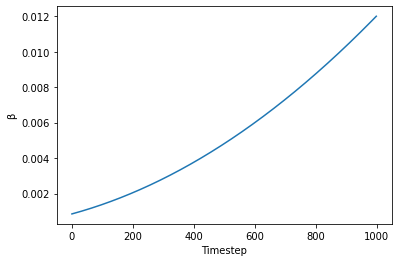

In [ ]:
beta_start, beta_end = 0.00085, 0.012
plt.plot(torch.linspace(beta_start ** 0.5, beta_end ** 0.5, 1000) ** 2)
plt.xlabel('Timestep')
plt.ylabel('β');

In [ ]:
from diffusers import LMSDiscreteScheduler

In [ ]:
scheduler = LMSDiscreteScheduler(beta_start=beta_start, beta_end=beta_end, beta_schedule="scaled_linear", num_train_timesteps=1000)

We now define the parameters we'll use for generation.

In contrast with the previous examples, we set `num_inference_steps` to 70 to get an even more defined image.

In [ ]:
prompt = ["a photograph of an astronaut riding a horse"]

height = 512
width = 512
num_inference_steps = 70
guidance_scale = 7.5
batch_size = 1

We tokenize the prompt. The model requires the same number of tokens for every prompt, so padding is used to ensure we meet the required length.

In [ ]:
text_input = tokenizer(prompt, padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
text_input['input_ids']

tensor([[49406,   320,  8853,   539,   550, 18376,  6765,   320,  4558, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407]])

In [ ]:
# tokenizer?

In [ ]:
tokenizer.decode(49406), tokenizer.decode(49407)

('<|startoftext|>', '<|endoftext|>')

The attention mask uses zero to represent tokens we are not interested in. These are all of the padding tokens.

In [ ]:
text_input['attention_mask']

tensor([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0]])

The text encoder gives us the embeddings for the text prompt we used.

In [ ]:
text_embeddings = text_encoder(text_input.input_ids.to("cuda"))[0].half()
text_embeddings.shape

torch.Size([1, 77, 768])

In [ ]:
# text_embeddings[0, 0, :]

We also get the embeddings required to perform unconditional generation, which is achieved with an empty string: the model is free to go in whichever direction it wants as long as it results in a reasonably-looking image. These embeddings will be applied to apply classifier-free guidance.

In [ ]:
max_length = text_input.input_ids.shape[-1]
uncond_input = tokenizer(
    [""] * batch_size, 
    padding="max_length", max_length=max_length, 
    return_tensors="pt"
)
uncond_embeddings = text_encoder(uncond_input.input_ids.to("cuda"))[0].half()
uncond_embeddings.shape

torch.Size([1, 77, 768])

For classifier-free guidance, we need to do two forward passes. One with the conditioned input (`text_embeddings`), and another with the unconditional embeddings (`uncond_embeddings`). In practice, we can concatenate both into a single batch to avoid doing two forward passes.

In [ ]:
text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
text_embeddings.shape

torch.Size([2, 77, 768])

To start the denoising process, we start from pure Gaussian (normal) noise. These are our initial latents.

Inspect the shapes of inputs, latents and output shapes of the VAE:

`vae encoder`:
- input image shape: `[3, height, width]`
- output = latents shape: `[8, height/8, width/8]`. As we have a VAE, it is actually 4 channels for $\mu$ and 4 channels for $\sigma^2$
    
`vae.decoder`:
- input = latents shape: The decoder will take a random sampling of shape `[4, height/8, width/8]` using $\mu$ and $\sigma^2$
- output image shape: `[3, height, width]`

Looking at the models themselves:

In [ ]:
# Nbr Channels at the input and outputs of VAE and UNET
vae.in_channels , vae.latent_channels, unet.in_channels, unet.out_channels, vae.latent_channels, vae.out_channels

(3, 4, 4, 4, 4, 3)

In [ ]:
e = list(vae.encoder.modules())
u = list(unet.modules())
d = list(vae.decoder.modules())

print( '                           Conv2d(channel_in, channel_out, ....)')

print(f"First layer VAE encoder:   {e[1]}")
print(f"Last layer VAE encoder:    {e[-1]}")
print()
print(f"First layer UNET:          {u[1]}")
print(f"Last layer UNET:           {u[-1]}")
print()
print(f"First layer VAE decoder:   {d[1]}")
print(f"Last layer VAE decoder:    {d[-1]}")

                           Conv2d(channel_in, channel_out, ....)
First layer VAE encoder:   Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
Last layer VAE encoder:    Conv2d(512, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))

First layer UNET:          Conv2d(4, 320, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
Last layer UNET:           Conv2d(320, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))

First layer VAE decoder:   Conv2d(4, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
Last layer VAE decoder:    Conv2d(128, 3, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))


In [ ]:
height, width = 512, 512
img = torch.rand((1, 3, height, width)).to("cuda").half()
latents_shape = vae.encoder(img).shape
print(f"Image with shape [3, {height}, {width}] will give latents of shape {latents_shape[1:]}")

Image with shape [3, 512, 512] will give latents of shape torch.Size([8, 64, 64])


Our latents will have 4 channels and feature map size of height/8, width/8

In [ ]:
torch.manual_seed(100)
latents = torch.randn((batch_size, unet.in_channels, height // 8, width // 8))
latents = latents.to("cuda").half()
latents.shape

torch.Size([1, 4, 64, 64])

`4×64×64` is the input shape for an image or size 512, 512. The decoder will later transform this latent representation into a `3×512×512` image after the denoising process is complete.

Next, we initialize the scheduler with our chosen `num_inference_steps`. This will prepare the internal state to be used during denoising.

In [ ]:
scheduler.set_timesteps(num_inference_steps)

We scale the initial noise by the standard deviation required by the scheduler. This value will depend on the particular scheduler we use.

In [ ]:
scheduler.init_noise_sigma.item()

14.614645004272461

In [ ]:
latents = latents * scheduler.init_noise_sigma

We are ready to write the denoising loop. The timesteps go from `999` to `0` (1000 steps that were used during training) following a particular schedule.

In [ ]:
scheduler.timesteps

tensor([999.0000, 984.5217, 970.0435, 955.5652, 941.0870, 926.6087, 912.1304,
        897.6522, 883.1739, 868.6957, 854.2174, 839.7391, 825.2609, 810.7826,
        796.3043, 781.8261, 767.3478, 752.8696, 738.3913, 723.9130, 709.4348,
        694.9565, 680.4783, 666.0000, 651.5217, 637.0435, 622.5652, 608.0870,
        593.6087, 579.1304, 564.6522, 550.1739, 535.6957, 521.2174, 506.7391,
        492.2609, 477.7826, 463.3043, 448.8261, 434.3478, 419.8696, 405.3913,
        390.9130, 376.4348, 361.9565, 347.4783, 333.0000, 318.5217, 304.0435,
        289.5652, 275.0870, 260.6087, 246.1304, 231.6522, 217.1739, 202.6957,
        188.2174, 173.7391, 159.2609, 144.7826, 130.3043, 115.8261, 101.3478,
         86.8696,  72.3913,  57.9130,  43.4348,  28.9565,  14.4783,   0.0000],
       dtype=torch.float64)

In [ ]:
scheduler.sigmas

tensor([14.6146, 13.3974, 12.3033, 11.3184, 10.4301,  9.6279,  8.9020,  8.2443,
         7.6472,  7.1044,  6.6102,  6.1594,  5.7476,  5.3709,  5.0258,  4.7090,
         4.4178,  4.1497,  3.9026,  3.6744,  3.4634,  3.2680,  3.0867,  2.9183,
         2.7616,  2.6157,  2.4794,  2.3521,  2.2330,  2.1213,  2.0165,  1.9180,
         1.8252,  1.7378,  1.6552,  1.5771,  1.5031,  1.4330,  1.3664,  1.3030,
         1.2427,  1.1852,  1.1302,  1.0776,  1.0272,  0.9788,  0.9324,  0.8876,
         0.8445,  0.8029,  0.7626,  0.7236,  0.6858,  0.6490,  0.6131,  0.5781,
         0.5438,  0.5102,  0.4770,  0.4443,  0.4118,  0.3795,  0.3470,  0.3141,
         0.2805,  0.2455,  0.2084,  0.1672,  0.1174,  0.0292,  0.0000])

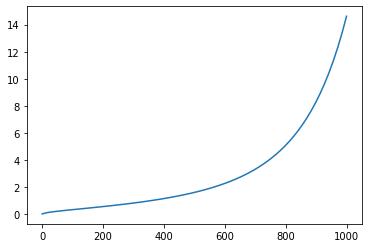

In [ ]:
plt.plot(scheduler.timesteps, scheduler.sigmas[:-1]);

In [ ]:
from tqdm.auto import tqdm

In [ ]:
for i, t in enumerate(tqdm(scheduler.timesteps)):
    input = torch.cat([latents] * 2)
    # scale_model_input(): Scales the denoising model input by `(sigma**2 + 1) ** 0.5` to match the K-LMS algorithm.
    input = scheduler.scale_model_input(input, t)

    # predict the noise residual
    with torch.no_grad(): pred = unet(input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    pred_uncond, pred_text = pred.chunk(2)
    pred = pred_uncond + guidance_scale * (pred_text - pred_uncond)

    # compute the "previous" noisy sample
    # step(): Predict the sample at the previous timestep by reversing the SDE. 
    #         Core function to propagate the diffusion process from the learned model outputs 

    latents = scheduler.step(pred, t, latents).prev_sample

  0%|          | 0/70 [00:00<?, ?it/s]

In [ ]:
# scheduler.scale_model_input?
# scheduler.step?

After this process completes our `latents` contain the denoised representation of the image. We use the `vae` decoder to convert it back to pixel space.

In [ ]:
with torch.no_grad(): image = vae.decode(1 / 0.18215 * latents).sample

And finally, let's convert the image to PIL so we can display it.

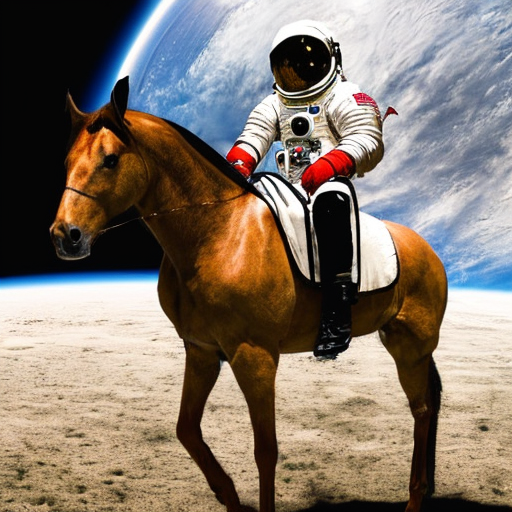

In [ ]:
def show_img(image):
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image[0].detach().cpu().permute(1, 2, 0).numpy()
    image = (image * 255).round().astype("uint8")
    return Image.fromarray(image)
show_img(image)

## Just the code

In [ ]:
prompts = [
    'a photograph of an astronaut riding a horse',
    'an oil painting of an astronaut riding a horse in the style of magritte'
]

num_inference_steps

70

In [ ]:
text_input = tokenizer(prompts, padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
text_embeddings = text_encoder(text_input.input_ids.to("cuda"))[0].half()

In [ ]:
max_length = text_input.input_ids.shape[-1]
uncond_input = tokenizer([""] * len(prompts), padding="max_length", max_length=max_length, return_tensors="pt")
uncond_embeddings = text_encoder(uncond_input.input_ids.to("cuda"))[0].half()
emb = torch.cat([uncond_embeddings, text_embeddings])

In [ ]:
torch.manual_seed(100)
g = guidance_scale

In [ ]:
latents = torch.randn((len(prompts), unet.in_channels, height//8, width//8))
scheduler.set_timesteps(num_inference_steps)
latents = latents.to("cuda").half() * scheduler.init_noise_sigma

In [ ]:
for i,ts in enumerate(tqdm(scheduler.timesteps)):
    inp = scheduler.scale_model_input(torch.cat([latents] * 2), ts)
    with torch.no_grad(): u,t = unet(inp, ts, encoder_hidden_states=emb).sample.chunk(2)
    pred = u + g*(t-u)
    latents = scheduler.step(pred, ts, latents).prev_sample

  0%|          | 0/70 [00:00<?, ?it/s]

In [ ]:
with torch.no_grad(): image = vae.decode(1 / 0.18215 * latents).sample
res = (image / 2 + 0.5).clamp(0, 1)

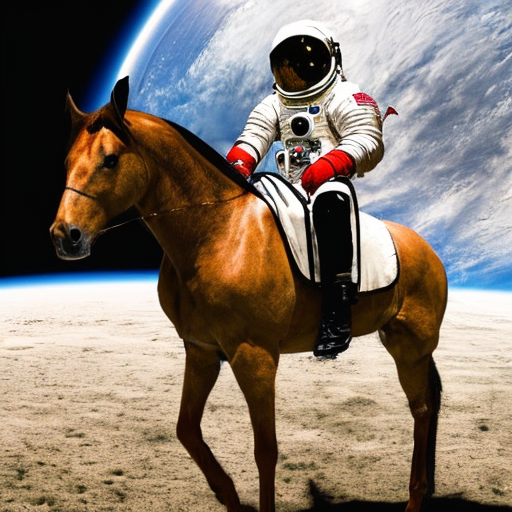

In [ ]:
image = res[0].detach().cpu().permute(1, 2, 0).numpy()
image = (image * 255).round().astype("uint8")
Image.fromarray(image)

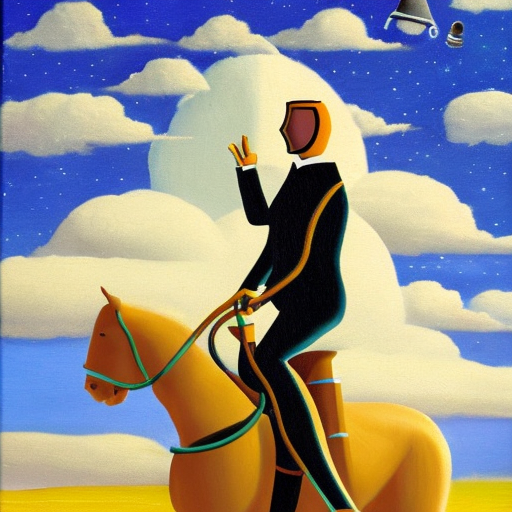

In [ ]:
image = res[1].detach().cpu().permute(1, 2, 0).numpy()
image = (image * 255).round().astype("uint8")
Image.fromarray(image)

# Min sufficient code and functions

There are several options for schedules:
- Pseudo numerical methods for diffusion models (PNDM) (default): `diffusers.PNDMScheduler`
- Linear multistep scheduler for discrete beta schedules (K-LMS) by Katherine Crowson: `diffusers.LMSDiscreteScheduler`
- Denoising diffusion implicit models (DDIM): `diffusers.DDIMScheduler`
- Denoising diffusion probabilistic models (DDPM): `diffusers.DDPMScheduler`

See [HF docs](https://huggingface.co/docs/diffusers/v0.6.0/en/api/schedulers) for other implemented schedulerss

In [29]:
from IPython.display import display
from diffusers import AutoencoderKL, UNet2DConditionModel
from diffusers import PNDMScheduler, LMSDiscreteScheduler
from tqdm.auto import tqdm
from transformers import CLIPTextModel, CLIPTokenizer

In [19]:
height = 512
width = 512
num_inference_steps = 70
g = guidance_scale = 7.5
bs = batch_size = 1

In [10]:
# Instanciate the tokenizer and the text encoder
tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-large-patch14", torch_dtype=torch.float16)
text_encoder = CLIPTextModel.from_pretrained("openai/clip-vit-large-patch14", torch_dtype=torch.float16).to("cuda")

# Instanciate the VAE and UNET (use a different VAE to the original release, which has been fine-tuned for more steps)
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-ema", torch_dtype=torch.float16).to("cuda")
unet = UNet2DConditionModel.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="unet", torch_dtype=torch.float16).to("cuda")

Downloading:   0%|          | 0.00/961k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/525k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/389 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/905 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/4.52k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.71G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/335M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/547 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/743 [00:00<?, ?B/s]

In [31]:
# LMSD:
#   num_train_timesteps (int) — number of diffusion steps used to train the model. Default=1000
#   beta_start (float) — the starting beta value of inference. Default=0.0001
#   beta_end (float) — the final beta value. Default=0.02
#   beta_schedule (str) — 'linear' (Default) or 'scaled_linear'.
beta_start, beta_end = 0.00085, 0.012
lmsd_scheduler = LMSDiscreteScheduler(beta_start=beta_start, beta_end=beta_end, beta_schedule="scaled_linear", num_train_timesteps=1000)
lmsd_scheduler.set_timesteps(num_inference_steps)
# PNDM:
#   num_train_timesteps (int)=1000 — number of diffusion steps used to train the model.
#   beta_start (float)=0.001 — the starting beta value of inference.
#   beta_end (float)=0.02 — the final beta value.
#   beta_schedule (str) — 'linear' (Default), 'scaled_linear'or 'squaredcos_cap_v2'.
pndm_scheduler = PNDMScheduler(beta_start=beta_start, beta_end=beta_end, beta_schedule="scaled_linear", num_train_timesteps=1000)

In [32]:
def text_enc(prompts, maxlen=None):
    if maxlen is None: maxlen = tokenizer.model_max_length
    inp = tokenizer(prompts, padding="max_length", max_length=maxlen, truncation=True, return_tensors="pt")
    return text_encoder(inp.input_ids.to("cuda"))[0].half()

def mk_img(t):
    image = (t/2 + 0.5).clamp(0,1).detach().cpu().permute(1, 2, 0).numpy()
    return Image.fromarray((image * 255).round().astype("uint8"))

def combine_imgs(imgs):
    # return torch.cat([im for im in images], dim=2)
    return torch.cat([im.squeeze() for im in imgs.chunk(images.shape[0])], dim=2)

In [42]:
def mk_samples(prompts, g=7.5, seed=100, steps=70, img_h=512, img_w=512, scheduler=lmsd_scheduler):
    bs = len(prompts)
    text = text_enc(prompts)
    uncond = text_enc([""] * bs, text.shape[1])
    emb = torch.cat([uncond, text])
    if seed: torch.manual_seed(seed)

    latents = torch.randn((bs, unet.in_channels, img_h//8, img_w//8))
    scheduler.set_timesteps(steps)
    latents = latents.to("cuda").half() * scheduler.init_noise_sigma

    for i,ts in enumerate(tqdm(scheduler.timesteps)):
        inp = scheduler.scale_model_input(torch.cat([latents] * 2), ts)
        with torch.no_grad(): u,t = unet(inp, ts, encoder_hidden_states=emb).sample.chunk(2)
        pred = u + g *(t-u)
        latents = scheduler.step(pred, ts, latents).prev_sample

    with torch.no_grad(): return vae.decode(1 / 0.18215 * latents).sample

  0%|          | 0/70 [00:00<?, ?it/s]

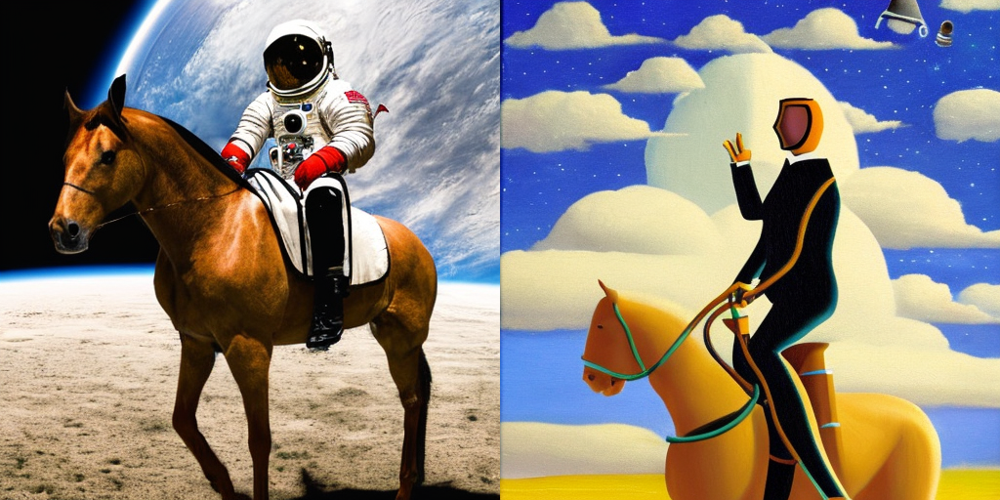

In [39]:
prompts = [
    'a photograph of an astronaut riding a horse',
    'an oil painting of an astronaut riding a horse in the style of magritte'
]

beta_start, beta_end = 0.00085, 0.012

lmsd_scheduler = LMSDiscreteScheduler(beta_start=beta_start, beta_end=beta_end, beta_schedule='scaled_linear', num_train_timesteps=1000)
lmsd_scheduler.set_timesteps(num_inference_steps)
images = mk_samples(prompts, scheduler=lmsd_scheduler)
display(mk_img(combine_imgs(images)))

## Experiment with different scheduler and beta schedules

In [37]:
beta_start, beta_end = 0.00085, 0.012
beta_schedules = 'linear scaled_linear'.split(' ')

for beta_schedule in beta_schedules:
    print(f"Using L-MSD scheduler with {beta_schedule} beta schedule")
    lmsd_scheduler = LMSDiscreteScheduler(beta_start=beta_start, beta_end=beta_end, beta_schedule=beta_schedule, num_train_timesteps=1000)
    lmsd_scheduler.set_timesteps(num_inference_steps)
    images = mk_samples(prompts, scheduler=lmsd_scheduler)
    display(mk_img(combine_imgs(images)))
    print('\n')

Output hidden; open in https://colab.research.google.com to view.

In [38]:
beta_start, beta_end = 0.00085, 0.012
beta_schedules = 'linear scaled_linear squaredcos_cap_v2'.split(' ')

for beta_schedule in beta_schedules:
    print(f"Using PNDM scheduler with {beta_schedule} beta schedule")
    pndm_scheduler = PNDMScheduler(beta_start=beta_start, beta_end=beta_end, beta_schedule=beta_schedule, num_train_timesteps=1000)
    pndm_scheduler.set_timesteps(num_inference_steps)
    images = mk_samples(prompts, scheduler=pndm_scheduler)
    display(mk_img(combine_imgs(images)))
    print('\n')

Output hidden; open in https://colab.research.google.com to view.

## Order of the prompts matters

> Note:
>
> To get identical result with passing a list of more than one prompt, it is important to keep the same prompts and the same number of prompts. For example, if we add one prompt between the original ones, the sampling of the latents for the third one will not be the same as with it was in position 2

Image 512x512 generated with guidance (g = 7.5)


  0%|          | 0/70 [00:00<?, ?it/s]

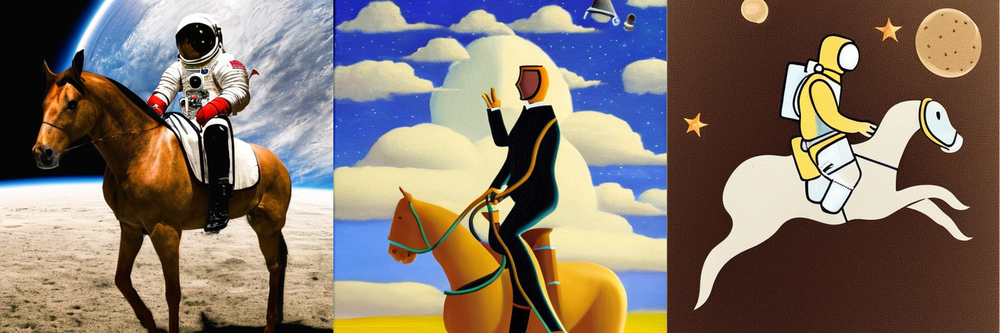

In [44]:
prompts = [
    'a photograph of an astronaut riding a horse',
    'an oil painting of an astronaut riding a horse in the style of magritte',
    'an astronaut riding a horse',
]
seed = 100
height, width = 512, 512

g = 7.5 * 1
print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_samples(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

Now we swap the order of the prompts

Image 512x512 generated with guidance (g = 7.5)


  0%|          | 0/70 [00:00<?, ?it/s]

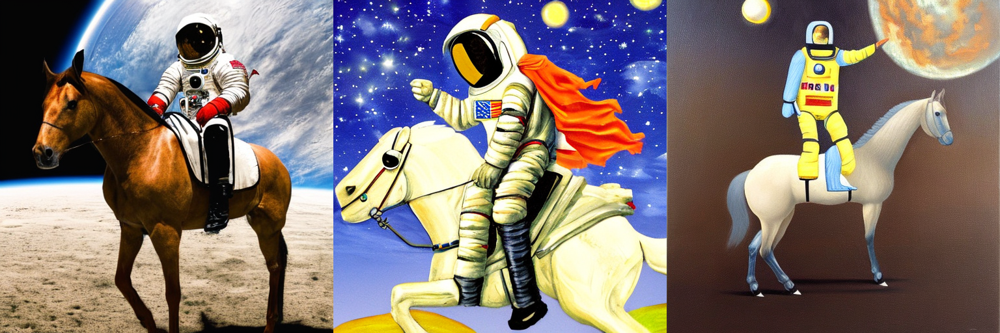

In [48]:
prompts = [
    'a photograph of an astronaut riding a horse',
    'an astronaut riding a horse',
    'an oil painting of an astronaut riding a horse in the style of magritte'
]

height, width = 8 * 64, 8 * 64

g = 7.5 * 1
print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_samples(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

## Why we use guidance ?

The loop uses two "paths", one using the prompt (`txt`) and one without the prompt (`unc`):
```
prompt -> txt_emb = txt_enc(prompts); txt_denoised_latents = unet(noizy_latent, txt_emb)  
''     -> unc = txt_enc('');          unc_denoised_latents = unet(noizy_latent, txt_emb)  
```

```python
    text = text_enc(prompts)
    uncond = text_enc([""] * bs, text.shape[1])
    emb = torch.cat([uncond, text])

    latents = torch.randn((bs, unet.in_channels, img_h//8, img_w//8))
    scheduler.set_timesteps(steps)
    latents = latents.to("cuda").half() * scheduler.init_noise_sigma

    for i,ts in enumerate(tqdm(scheduler.timesteps)):
        inp = scheduler.scale_model_input(torch.cat([latents] * 2), ts)
        with torch.no_grad(): u,t = unet(inp, ts, encoder_hidden_states=emb).sample.chunk(2)
        pred = u + g *(t-u)
```

In [137]:
def mk_img(t, resized_to=None):
    image = (t/2 + 0.5).clamp(0,1).detach().cpu().permute(1, 2, 0).numpy()
    im = Image.fromarray((image * 255).round().astype("uint8"))
    if resized_to is not None:
        im = im.resize(size=resized_to)
    return im

In [151]:
def under_the_hood(prompts, g=7.5, steps=70, seed=100, img_h=512, img_w=512, scheduler=lmsd_scheduler, display_step=5, guidance=True):
    if len(prompts) > 1:
        print('This function only takes a single prompt. Picking the first one')
        prompts = prompts[0]
    bs = 1
    text = text_enc(prompts)
    uncond = text_enc([""] * bs, text.shape[1])
    emb = torch.cat([uncond, text])
    if seed: torch.manual_seed(seed)

    # Utility display functions
    def normalize2img(*ts):
        img_list = []
        for t in ts: 
            t_min = t.min()
            t_max = t.max()
            img_list.append((t - t_min)/(t_max-t_min))
        return img_list

    def display_noisy():
        print(f"Noisy: Unconditional - Conditional - Combined - Diff")
        ts_list = normalize2img(u[0, :, :, :], t[0, :, :, :], pred[0, :, :, :], u[0, :, :, :]- t[0, :, :, :])
        display(mk_img(torch.cat(ts_list, dim=2), resized_to=(128*len(ts_list), 128)))

    def display_sampled_imgs():
        print(f"Denoised: Unconditional - Conditional - Combined")
        display(mk_img(torch.cat([u_imgs[0, :, :, :], t_imgs[0, :, :, :], imgs[0, :, :, :]], dim=2), resized_to=(128*3, 128)))

    # Initial noisy latents
    latents = torch.randn((bs, unet.in_channels, img_h//8, img_w//8))
    scheduler.set_timesteps(steps)
    latents = latents.to("cuda").half() * scheduler.init_noise_sigma

    # Inference loop
    for i,ts in enumerate(tqdm(scheduler.timesteps)):
            
        inp = scheduler.scale_model_input(torch.cat([latents] * 2), ts)
        with torch.no_grad(): u,t = unet(inp, ts, encoder_hidden_states=emb).sample.chunk(2)

        if guidance:
            pred = u + g * (t-u)
        else:
            pred = t

        latents = scheduler.step(pred, ts, latents).prev_sample
        u_latents = scheduler.step(u, ts, latents).prev_sample
        t_latents = scheduler.step(t, ts, latents).prev_sample

        with torch.no_grad():
            imgs = vae.decode(1 / 0.18215 * latents).sample
            u_imgs = vae.decode(1 / 0.18215 * u_latents).sample
            t_imgs = vae.decode(1 / 0.18215 * t_latents).sample
        
        if i%display_step == 0:
            print(f"Noisy Latents at step {i:02d} timestep {ts}  noise level sigma {scheduler.sigmas[i]}")
            display_noisy()
            display_sampled_imgs()

    print(f"Noisy Latents at step {i:02d} timestep {ts}  noise level sigma {scheduler.sigmas[i]}")
    display_noisy()
    display_sampled_imgs()

  0%|          | 0/51 [00:00<?, ?it/s]

Noisy Latents at step 00 timestep 999.0  noise level sigma 14.614645004272461
Noisy: Unconditional - Conditional - Combined - Diff


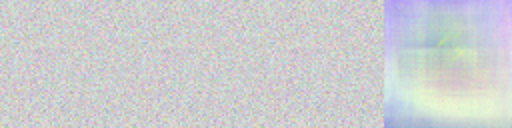

Denoised: Unconditional - Conditional - Combined


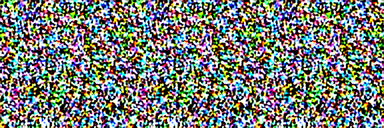

Noisy Latents at step 20 timestep 599.4  noise level sigma 2.2797346115112305
Noisy: Unconditional - Conditional - Combined - Diff


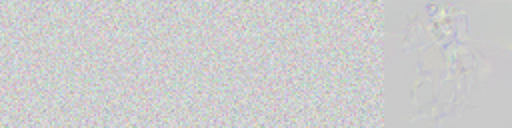

Denoised: Unconditional - Conditional - Combined


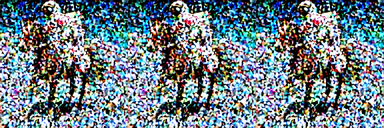

Noisy Latents at step 40 timestep 199.8  noise level sigma 0.5711901783943176
Noisy: Unconditional - Conditional - Combined - Diff


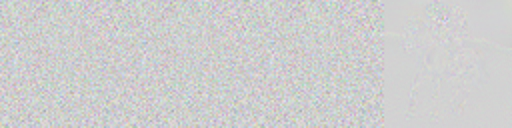

Denoised: Unconditional - Conditional - Combined


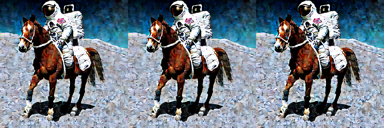

Noisy Latents at step 50 timestep 0.0  noise level sigma 0.029167532920837402
Noisy: Unconditional - Conditional - Combined - Diff


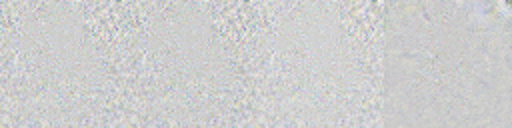

Denoised: Unconditional - Conditional - Combined


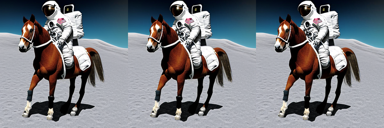

In [149]:
prompts = ['astronaut riding a horse on the moon']
res = under_the_hood(prompts, g=7.5, steps=51, seed=1000, img_h=512, img_w=512, scheduler=lmsd_scheduler, display_step=20);

  0%|          | 0/51 [00:00<?, ?it/s]

Noisy Latents at step 00 timestep 999.0  noise level sigma 14.614645004272461
Noisy: Unconditional - Conditional - Combined - Diff


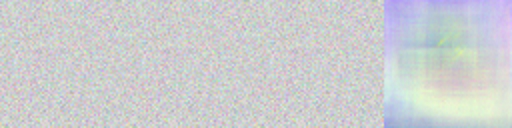

Denoised: Unconditional - Conditional - Combined


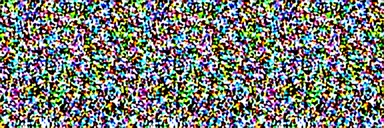

Noisy Latents at step 20 timestep 599.4  noise level sigma 2.2797346115112305
Noisy: Unconditional - Conditional - Combined - Diff


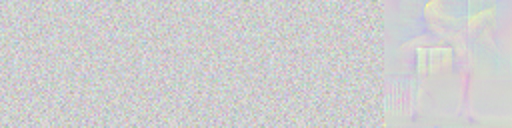

Denoised: Unconditional - Conditional - Combined


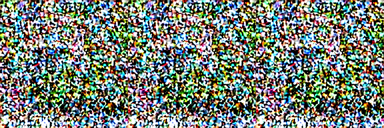

Noisy Latents at step 40 timestep 199.8  noise level sigma 0.5711901783943176
Noisy: Unconditional - Conditional - Combined - Diff


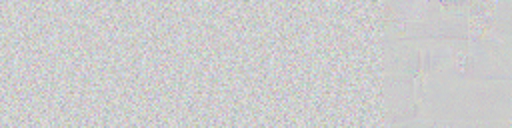

Denoised: Unconditional - Conditional - Combined


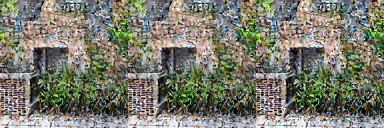

Noisy Latents at step 50 timestep 0.0  noise level sigma 0.029167532920837402
Noisy: Unconditional - Conditional - Combined - Diff


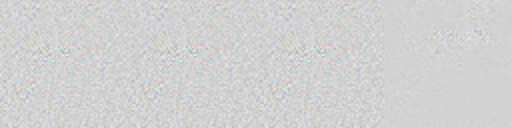

Denoised: Unconditional - Conditional - Combined


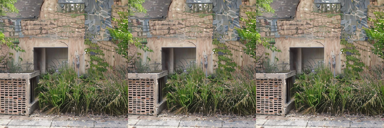

In [154]:
prompts = ['astronaut riding a horse on the moon']
res = under_the_hood(prompts, g=7.5, steps=51, seed=1000, img_h=512, img_w=512, scheduler=lmsd_scheduler, display_step=20, guidance=False)

  0%|          | 0/51 [00:00<?, ?it/s]

Noisy Latents at step 00 timestep 999.0  noise level sigma 14.614645004272461
Noisy: Unconditional - Conditional - Combined - Diff


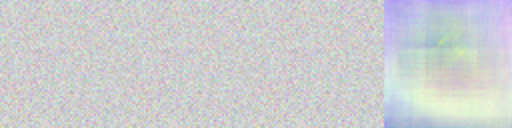

Denoised: Unconditional - Conditional - Combined


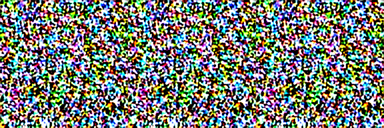

Noisy Latents at step 20 timestep 599.4  noise level sigma 2.2797346115112305
Noisy: Unconditional - Conditional - Combined - Diff


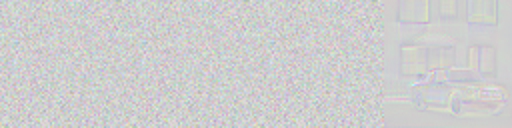

Denoised: Unconditional - Conditional - Combined


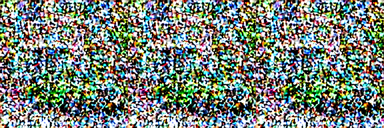

Noisy Latents at step 40 timestep 199.8  noise level sigma 0.5711901783943176
Noisy: Unconditional - Conditional - Combined - Diff


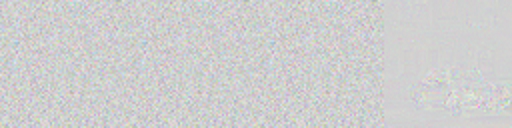

Denoised: Unconditional - Conditional - Combined


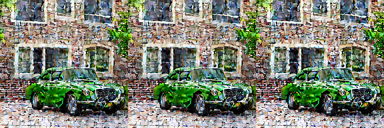

Noisy Latents at step 50 timestep 0.0  noise level sigma 0.029167532920837402
Noisy: Unconditional - Conditional - Combined - Diff


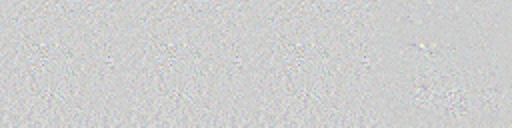

Denoised: Unconditional - Conditional - Combined


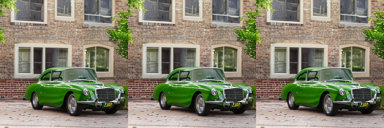

In [150]:
prompts = ['astronaut riding a horse on the moon']
res = under_the_hood(prompts, g=0, steps=51, seed=1000, img_h=512, img_w=512, scheduler=lmsd_scheduler, display_step=20);

In [ ]:
prompts = ['astronaut riding a horse on the moon']
res = under_the_hood(prompts, g=1, steps=51, seed=1000, img_h=512, img_w=512, scheduler=lmsd_scheduler, display_step=20);

In [ ]:
prompts = ['astronaut riding a horse on the moon']
res = under_the_hood(prompts, g=3, steps=51, seed=1000, img_h=512, img_w=512, scheduler=lmsd_scheduler, display_step=20);

In [ ]:
prompts = ['astronaut riding a horse on the moon']
res = under_the_hood(prompts, g=6, steps=51, seed=1000, img_h=512, img_w=512, scheduler=lmsd_scheduler, display_step=20);

## Experiments with sizes

Image 320x320 generated with guidance (g = 0)


  0%|          | 0/70 [00:00<?, ?it/s]

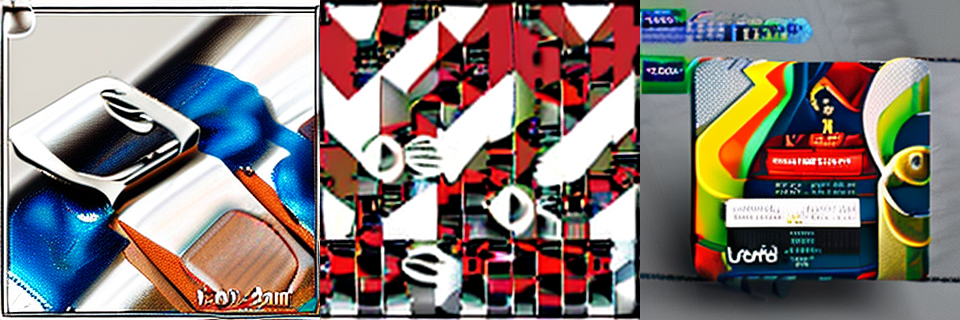

Image 320x320 generated with guidance (g = 7.5)


  0%|          | 0/70 [00:00<?, ?it/s]

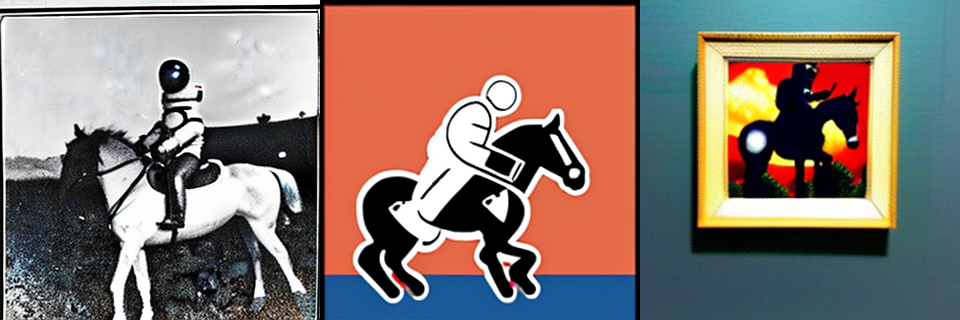

In [ ]:
height, width = 8 * 40, 8 * 40
seed = 100
num_inference_steps = 70

g = 0
print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

g = 7.5 * 1
print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

Image 320x320 generated with guidance (g = 1.875)


  0%|          | 0/70 [00:00<?, ?it/s]

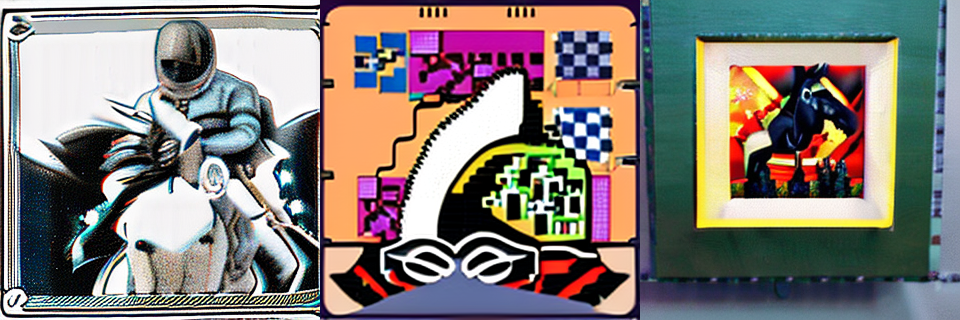

In [ ]:
g = 7.5 * 0.25

print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

Image 320x320 generated with guidance (g = 3.75)


  0%|          | 0/70 [00:00<?, ?it/s]

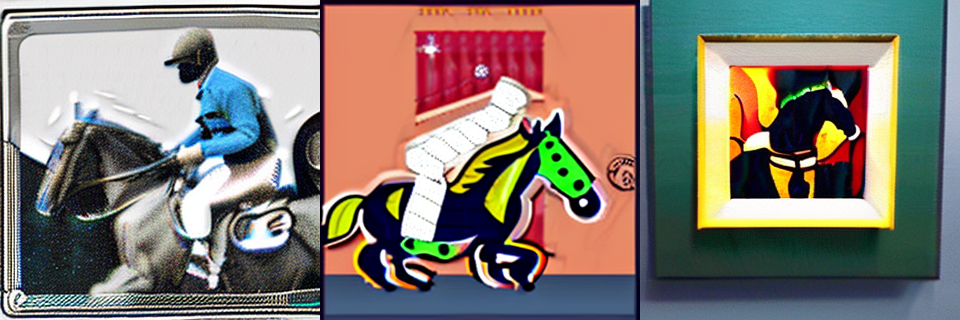

In [ ]:
g = 7.5 * 0.5

print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

Image 320x320 generated with guidance (g = 5.625)


  0%|          | 0/70 [00:00<?, ?it/s]

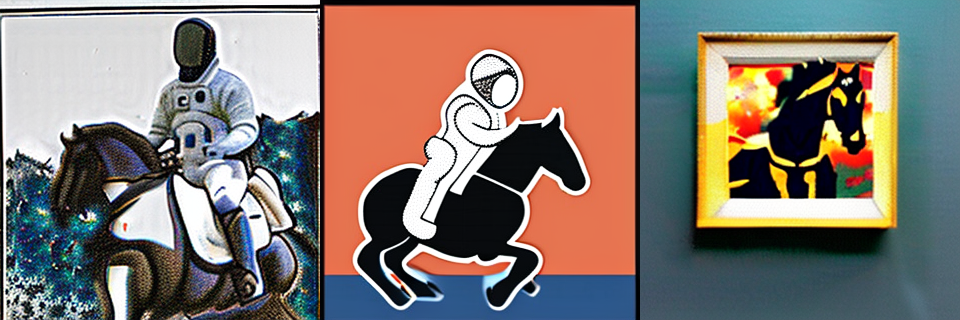

In [ ]:
g = 7.5 * .75

print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

Image 320x320 generated with guidance (g = 11.25)


  0%|          | 0/70 [00:00<?, ?it/s]

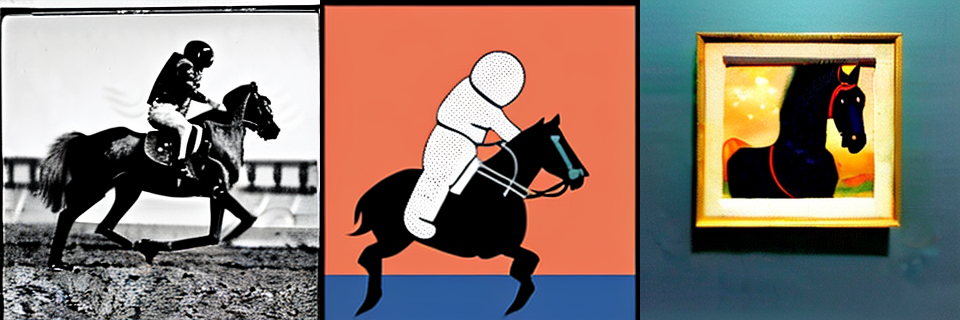

In [ ]:
g = 7.5 * 1.5

print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

Image 320x320 generated with guidance (g = 15.0)


  0%|          | 0/70 [00:00<?, ?it/s]

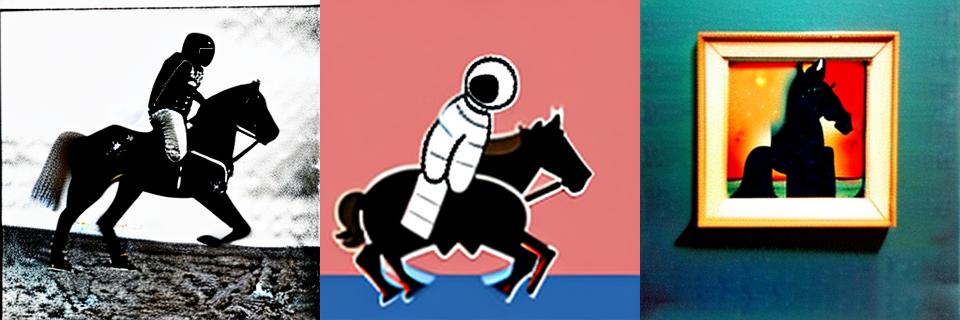

In [ ]:
g = 7.5 * 2

print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

Image 320x320 generated with guidance (g = 18.75)


  0%|          | 0/70 [00:00<?, ?it/s]

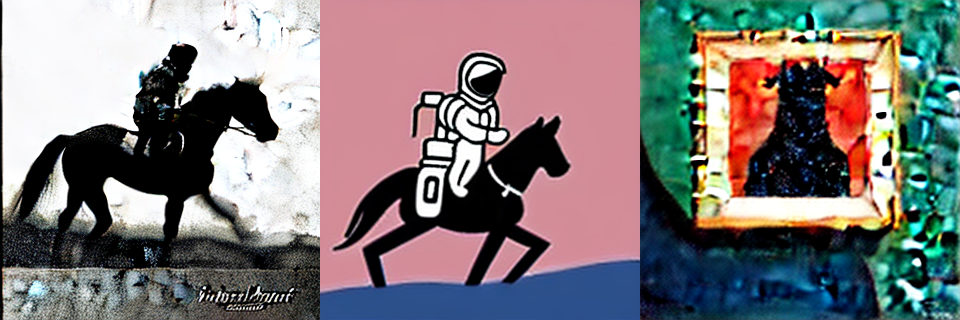

In [ ]:
g = 7.5 * 2.5

print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

Image 320x320 generated with guidance (g = 22.5)


  0%|          | 0/70 [00:00<?, ?it/s]

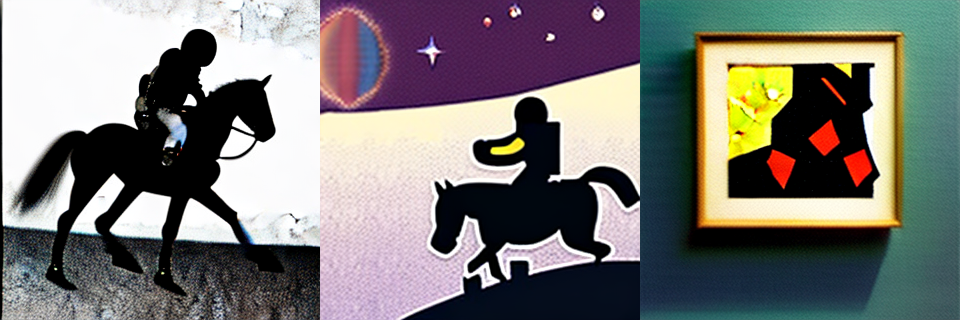

In [ ]:
g = 7.5 * 3

print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

In [ ]:
height, width = 8 * 50, 8 * 50

g = 0
print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

g = 7.5 * 1
print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
height, width = 8 * 64, 8 * 70

g = 0
print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

g = 7.5 * 1
print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

Output hidden; open in https://colab.research.google.com to view.

Image 256x512 generated with guidance (g = 7.5)


  0%|          | 0/70 [00:00<?, ?it/s]

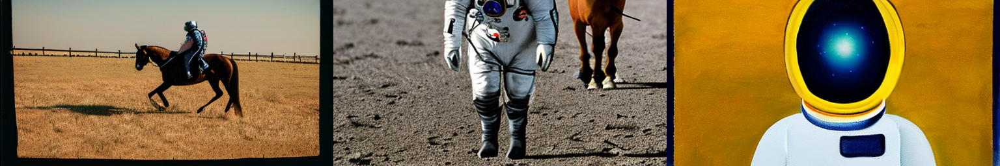

In [ ]:
height, width = 8 * 32, 8 * 64

g = 7.5 * 1
print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

Image 512x600 generated with guidance (g = 7.5)


  0%|          | 0/70 [00:00<?, ?it/s]

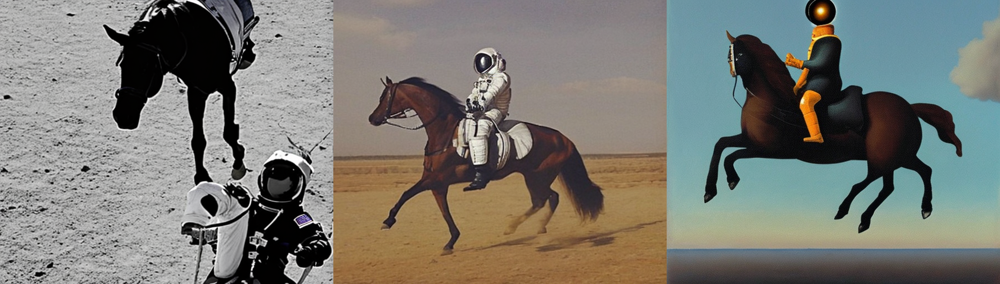

In [ ]:
height, width = 8 * 64, 8 * 75

g = 7.5 * 1
print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))

Image 560x560 generated with guidance (g = 7.5)


  0%|          | 0/70 [00:00<?, ?it/s]

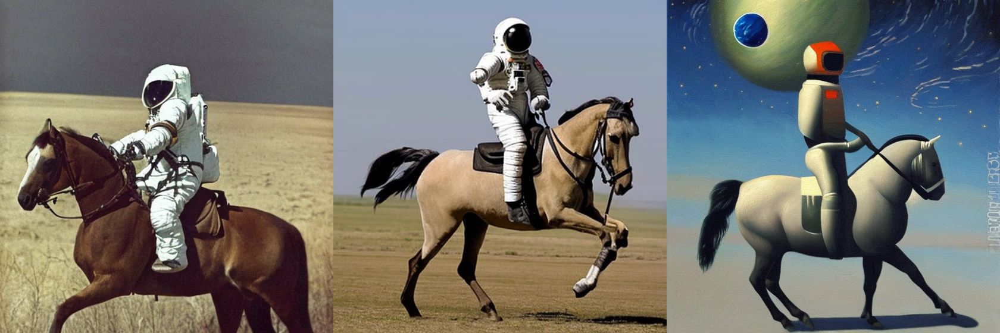

In [ ]:
height, width = 8 * 70, 8 * 70

g = 7.5 * 1
print(f"Image {height}x{width} generated with guidance (g = {g})")
images = mk_imgs_w_img_size(prompts, g=g, seed=seed, steps=num_inference_steps, img_h=height, img_w=width )
display(mk_img(combine_imgs(images)))